# Music Recommendation System

Import The libraries, download and read the data

In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
from sklearn.metrics import silhouette_score


import warnings
warnings.filterwarnings("ignore")

In [2]:
data = pd.read_csv(r"C:\Users\kadda\Downloads\SpotifyDataSet\data\data.csv")
genre_data = pd.read_csv(r"C:\Users\kadda\Downloads\SpotifyDataSet\data\data_by_genres.csv")
year_data = pd.read_csv(r"C:\Users\kadda\Downloads\SpotifyDataSet\data\data_by_year.csv")

In [3]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
print(data.describe())

             valence           year   acousticness   danceability  \
count  170653.000000  170653.000000  170653.000000  170653.000000   
mean        0.528587    1976.787241       0.502115       0.537396   
std         0.263171      25.917853       0.376032       0.176138   
min         0.000000    1921.000000       0.000000       0.000000   
25%         0.317000    1956.000000       0.102000       0.415000   
50%         0.540000    1977.000000       0.516000       0.548000   
75%         0.747000    1999.000000       0.893000       0.668000   
max         1.000000    2020.000000       0.996000       0.988000   

        duration_ms         energy       explicit  instrumentalness  \
count  1.706530e+05  170653.000000  170653.000000     170653.000000   
mean   2.309483e+05       0.482389       0.084575          0.167010   
std    1.261184e+05       0.267646       0.278249          0.313475   
min    5.108000e+03       0.000000       0.000000          0.000000   
25%    1.698270e+05    

In [5]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


### Text cleaning

In [6]:
import re

def clean_text(text):
    text = re.sub(r"[^a-zA-Z\s]", "", text)  # Remove special characters
    return text.lower().strip()

# Apply text cleaning
data['name'] = data['name'].apply(clean_text)
genre_data['genres'] = genre_data['genres'].apply(clean_text)
print("Text cleaning applied.")


Text cleaning applied.


In [7]:
# Select numerical features for clustering and analysis
numeric_features = ['danceability', 'energy', 'key', 'loudness', 
                    'mode', 'speechiness', 'acousticness', 
                    'instrumentalness', 'liveness', 'valence', 
                    'tempo', 'popularity']

# Normalize features using StandardScaler
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data[numeric_features])
print("Features scaled for analysis.")


Features scaled for analysis.


In [8]:
from sklearn.decomposition import PCA

# Reduce dimensionality to 10 components for embedding
pca = PCA(n_components=10)
embedded_data = pca.fit_transform(scaled_data)
print("Data embedded into latent space.")


Data embedded into latent space.


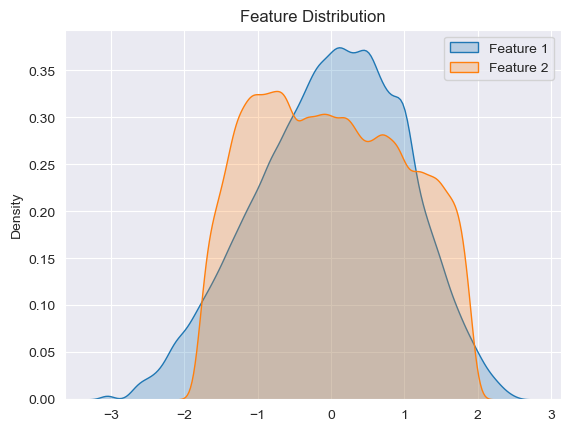

In [21]:
# Plot the distribution of the first two scaled features
sns.kdeplot(scaled_data[:, 0], label='Feature 1', shade=True)
sns.kdeplot(scaled_data[:, 1], label='Feature 2', shade=True)
plt.title("Feature Distribution")
plt.legend()
plt.show()

In [19]:
# Clustering
from sklearn.cluster import KMeans

num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
clusters = kmeans.fit_predict(embedded_data)

print("Clustering completed.")


Clustering completed.


<Figure size 800x600 with 0 Axes>

<Figure size 800x600 with 0 Axes>

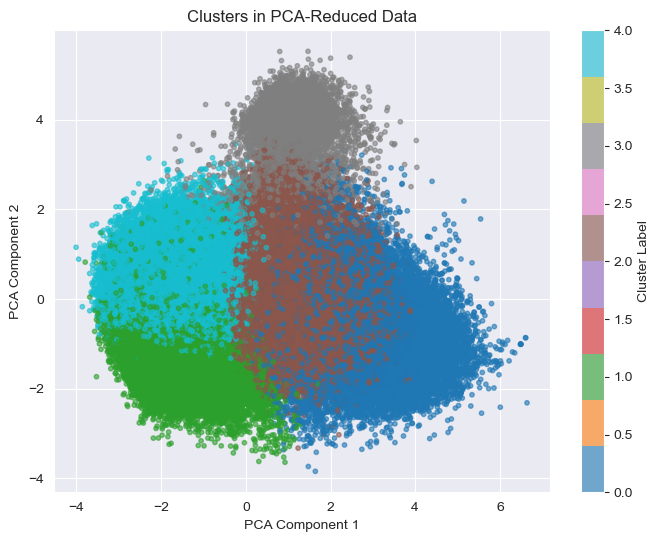

In [20]:
# Visualize clusters
plt.figure(figsize=(8, 6))
plt.scatter(embedded_data[:, 0], embedded_data[:, 1], c=clusters, cmap='tab10', s=10, alpha=0.6)
plt.title("Clusters in PCA-Reduced Data")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Cluster Label")
plt.show()


In [11]:
from sklearn.manifold import TSNE

# Reduce dimensions to 2D using t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_data = tsne.fit_transform(embedded_data)

# Create a DataFrame for visualization
tsne_df = pd.DataFrame(tsne_data, columns=['x', 'y'])
tsne_df['cluster'] = data['cluster']

# Plot the clusters
fig = px.scatter(tsne_df, x='x', y='y', color='cluster', title="Cluster Visualization")
fig.show()


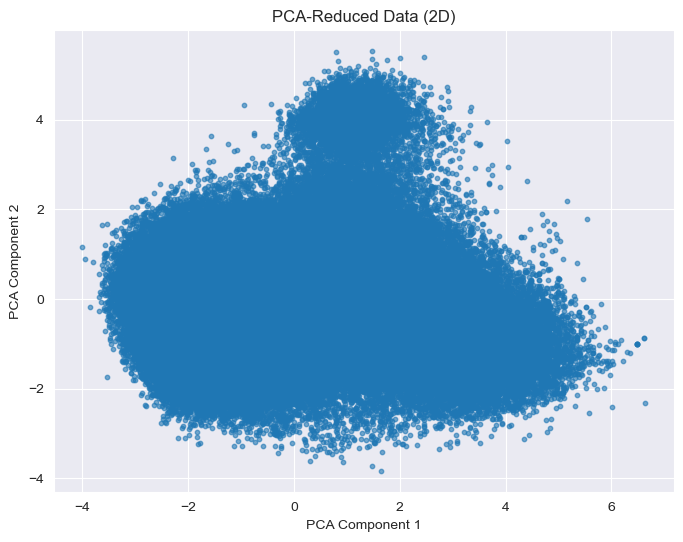

In [16]:
# 2D Scatter plot of PCA-reduced data
plt.figure(figsize=(8, 6))
plt.scatter(embedded_data[:, 0], embedded_data[:, 1], s=10, alpha=0.6, cmap='viridis')
plt.title("PCA-Reduced Data (2D)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.show()

In [13]:
def recommend_songs(song_list, spotify_data, n_songs=10):
    # Compute the mean vector of the input songs
    input_vectors = spotify_data[spotify_data['name'].isin(song_list)][numeric_features]
    mean_vector = np.mean(input_vectors, axis=0)

    # Calculate distances from mean vector to other songs
    distances = cdist([mean_vector], scaled_data, 'cosine')
    indices = np.argsort(distances[0])[:n_songs]

    return spotify_data.iloc[indices][['name', 'artists', 'year']]

# Example recommendation
recommend_songs(['smells like teen spirit'], data)


,name,artists,year
35003,lamento de amor,['Rigo Tovar'],2002
85171,ti amo,['Laura Branigan'],1984
134504,aint no cure for love,['Leonard Cohen'],1988
55462,grandpa tell me bout the good old days,['The Judds'],2011
87939,no puedo olvidarlo,['Marisela'],1998
4606,mele kalikimaka merry christmas,"['Bing Crosby', 'The Andrews Sisters']",1945
10687,the ride,['David Allan Coe'],1975
155032,wanted man,['Mat Kearney'],2018
12025,islands in the stream,"['Dolly Parton', 'Kenny Rogers']",1982
57091,lover remix feat shawn mendes,"['Taylor Swift', 'Shawn Mendes']",2019


In [14]:
# Evaluate clustering quality
sil_score = silhouette_score(embedded_data, data['cluster'])
print(f"Silhouette Score: {sil_score}")

# Manual evaluation: Provide recommendations and check for user relevance
example_recommendations = recommend_songs(['come as you are'], data)
print("Recommended songs:")
print(example_recommendations)


Silhouette Score: 0.1418928546931021
Recommended songs:
                                          name  \
35003                          lamento de amor   
85171                                   ti amo   
134504                   aint no cure for love   
55462   grandpa tell me bout the good old days   
87939                       no puedo olvidarlo   
4606           mele kalikimaka merry christmas   
12025                    islands in the stream   
10687                                 the ride   
57091            lover remix feat shawn mendes   
155032                              wanted man   

                                       artists  year  
35003                           ['Rigo Tovar']  2002  
85171                       ['Laura Branigan']  1984  
134504                       ['Leonard Cohen']  1988  
55462                            ['The Judds']  2011  
87939                             ['Marisela']  1998  
4606    ['Bing Crosby', 'The Andrews Sisters']  1945  
12025   